## Vehicle Detection Project

The goals / steps of this project are the following:

- Perform a Histogram of Oriented Gradients (HOG) feature extraction on a labeled training set of images and train a classifier to detect cars/not-cars
- Explore applying a color transform and append binned color features, as well as histograms of color, along with HOG feature vector
- Implement a sliding-window technique and use trained classifier to search for vehicles in images
- Run pipeline on a video stream and create a heat map of recurring detections frame by frame to reject outliers and follow detected vehicles.
- Estimate a bounding box for vehicles detected.


### Code:
- featurizer.py : code for generating color features (spatial binning, color histogram) and shape features (Histogram of Gradients HOG)
- classifier_trainer.py : code to read labeled images, extract features and train a LinearSVM classifier
- config.py : contains parameter values for features
- window_search.py : sliding window implementation to search for cars in image
- detection_pipeline.py : code to build heat map from sliding window detections. Handling false positives.
- image_utils.py : code to draw bounding boxes on image and related
- plot_utils.py : helper code to plot images
- explore_color_spaces.py : debugging code to explore different color transformation schemes

### Outputs:
- test_video_output.mp4 : result of applying my detection pipeline to smaller test video
- project_video_output.mp4 : applying detection pipeline on the larger project video



In [1]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

import pickle
import glob
import cv2

from plot_utils import grid_plot
from detection_pipeline import detect_vehicles
from sklearn.utils import resample

% matplotlib inline

### Exploring data

I am using GTI and KITTI labeled data. Data is separated into 2 directories (cars and not-cars).

Here are some sample examples of data. You can see the total count of cars labeled and not-cars labeled.

num vehicle images : 9312
num non vehicle images : 9748
image shape:  (64, 64, 3)


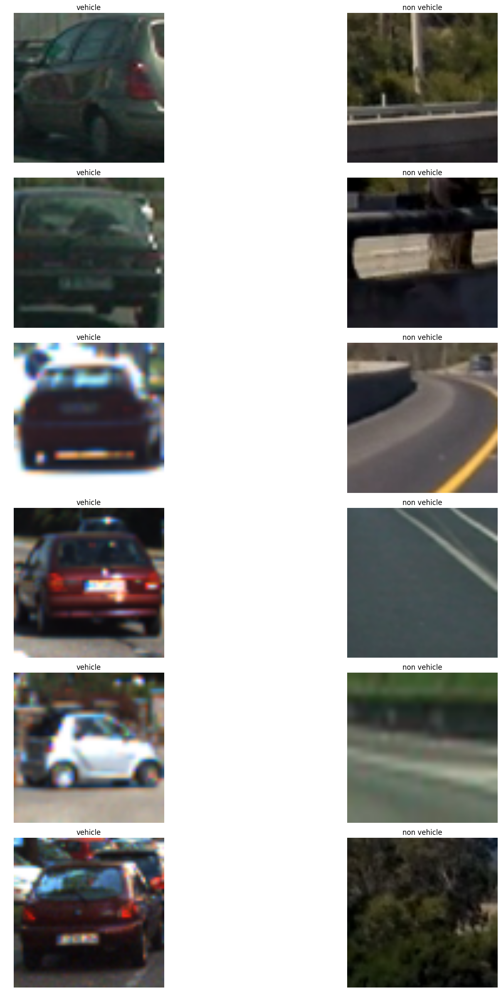

In [2]:
vehicle_paths = glob.glob('data/vehicles/*/*.png')
non_vehicle_paths = glob.glob('data/non-vehicles/*/*.png')

print("num vehicle images : %d"%len(vehicle_paths))
print("num non vehicle images : %d"%len(non_vehicle_paths))

vehicle_sample_images = [mpimg.imread(path) for path in 
                         resample(vehicle_paths, n_samples=6, random_state=0)]
non_vehicle_sample_images = [mpimg.imread(path) for path in 
                             resample(non_vehicle_paths, n_samples=6, random_state=0)]

print("image shape: ", vehicle_sample_images[0].shape)

grid_plot( [("vehicle", vehicle_sample_images),
           ("non vehicle", non_vehicle_sample_images)])

### Exploring color space transformation

Looking at sample images, our training data contains vehicles and non-vehicles in different light conditions. Before applying HOG transformation, I am exploring different color transformation schemes to see if a particular channel separates out vehicle outlines from background.

#### HSV transform

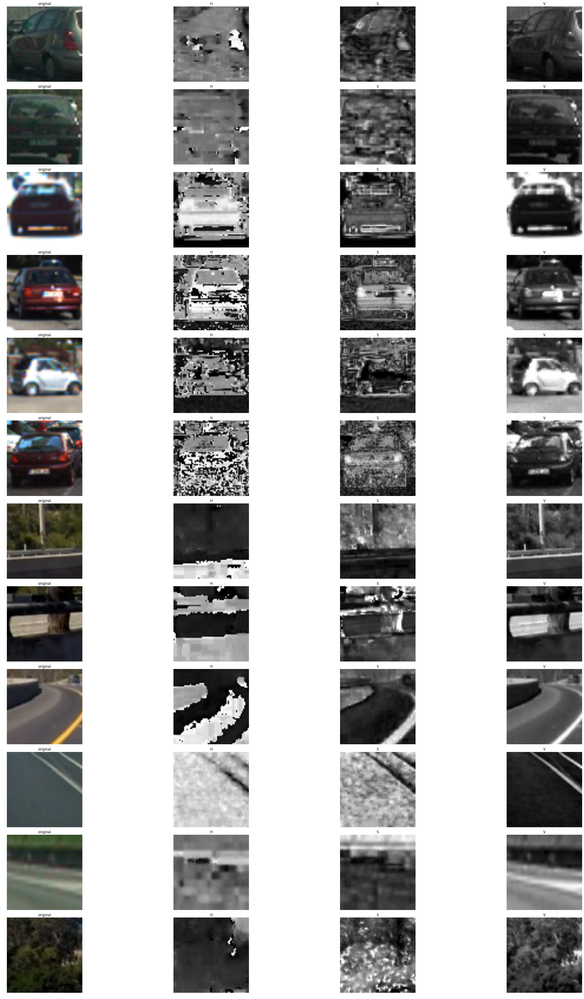

In [3]:
from explore_color_spaces import *
samples = vehicle_sample_images + non_vehicle_sample_images

show_hsv_images(samples)

#### HLS transform:

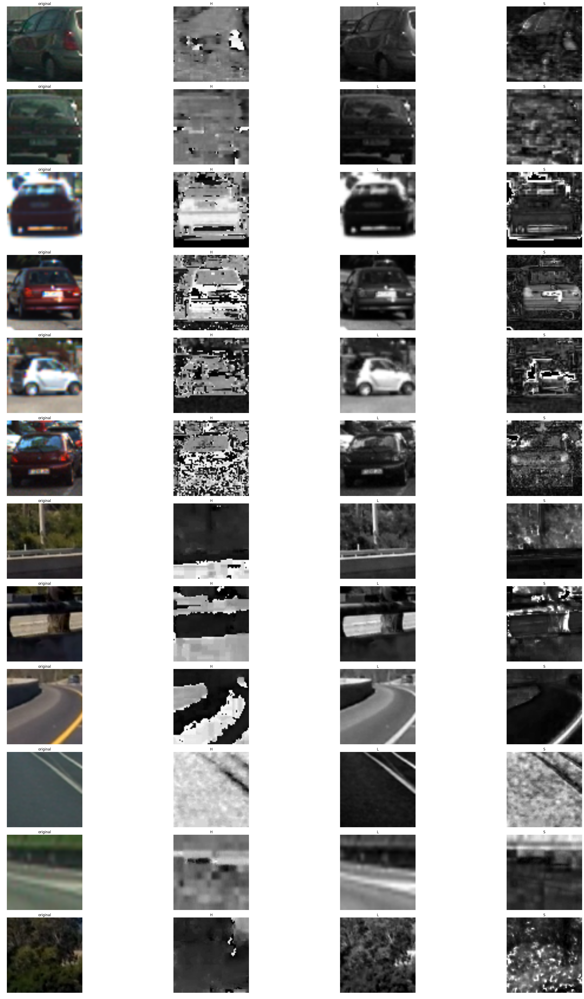

In [4]:
show_hls_images(samples)

#### YCrCb transform:

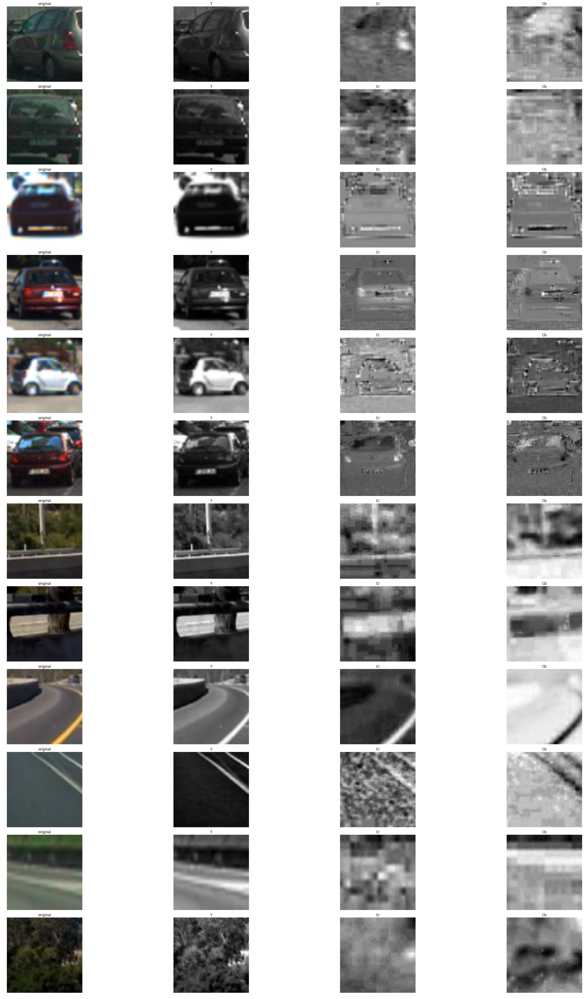

In [5]:
show_ycrcb_images(samples)

Looking at the above images, using S channel in HSV transformation seems to highlight cars well.

Using Cb channel in YCrCb transfomration also looks like a good alternative.

##### I chose YCrCb color transformation since I was getter better performance in car detection with this transformation

### Color features:

I explored 2 features that encode color information in image.

#### Spatial binning of color:
The images we are using for training are 64x64x3. Encoding the color values for each pixel will blow up feature space. Instead, we can reduce resolution of image to 16x16 or 32x32 and use color values. This will reduce feature space significantly.

Here is a comparison of car image down sampled to 64x64 and 32x32 respectively.
We can see that even at 32x32, car is clearly visible to human eye, which means relevant features are still preserved at this resoultion

<img src="report/spatial_binning.png" style="width: 600px;"/>



#### Histograms of color:
We have three channels in an image (RGB/HLS/HSV/YCrCb).
One important feature is to see the spread of color channel values for each of the three channels.

For a RGB image, color histogram can be computed like this:

```
# Take histograms in R, G, and B
rhist = np.histogram(image[:,:,0], bins=32)
ghist = np.histogram(image[:,:,1], bins=32)
bhist = np.histogram(image[:,:,2], bins=32)
```

<img src="report/color_histogram.png" style="width: 700px;"/>
Histogram values (y-axis) for all the three channels can be appended together to form a color histogram feature vector

#### Exploring parameters for color features:
I explored accuracy of a simple linear SVM classifier by varying the parameters for color based features.

Parameter for spatial binning is the size of result image. I am representing this as field named 'spatial;.

Parameter for histograms of color is the number of bins in color histogram. I am representing this as field named 'histbins'

Here is how each of these features influences accuracy:

<img src="report/spatial_hist_table.png" style="width: 200px;"/>

##### Sweet spot seems to be spatial binning of (16x16) with 32 color histograms bins 



### Histogram of Gradients (HOG) features:
After converting image to YCrCb space, I am getting hog features for each channel in the image. At the end, I am appending hog features from each channel together as a single feature vector.

Here are some examples of HOG transformation over each channel.


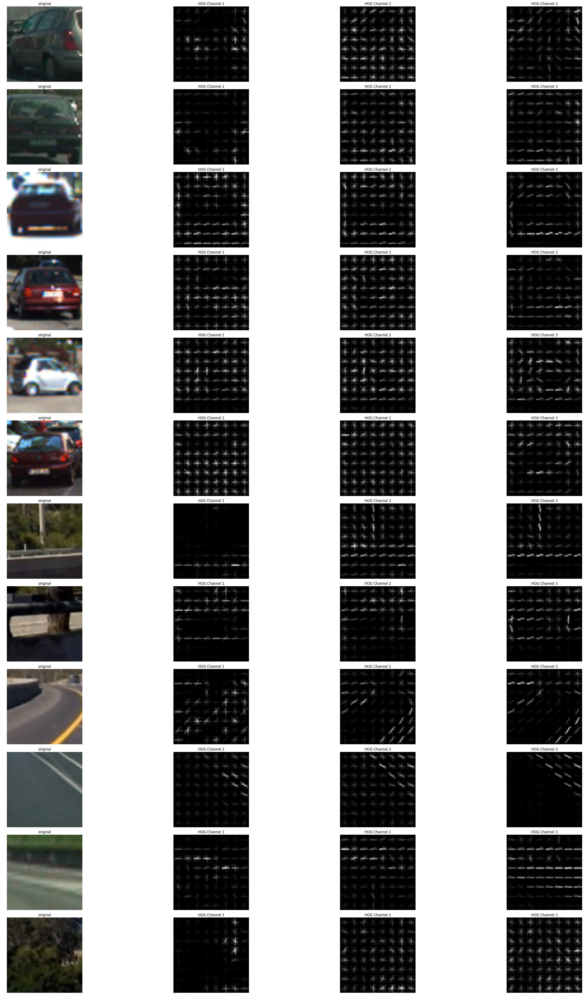

In [6]:
from featurizer import get_hog_features
color_transforms = [cv2.cvtColor(image, cv2.COLOR_RGB2HSV) for image in samples]
hog1_imgs = []
hog2_imgs = []
hog3_imgs = []
for img in color_transforms:
    _, hog1_image = get_hog_features(img[:,:,0], 12, 8, 2, vis=True)
    hog1_imgs.append(hog1_image)
    _, hog2_image = get_hog_features(img[:,:,1], 12, 8, 2, vis=True)
    hog2_imgs.append(hog2_image)
    _, hog3_image = get_hog_features(img[:,:,2], 12, 8, 2, vis=True)
    hog3_imgs.append(hog3_image)
    

grid_plot( [('original', samples),
            ('HOG Channel 1', hog1_imgs),
            ('HOG Channel 2', hog2_imgs),
            ('HOG Channel 3', hog3_imgs)])

HOG output of channel 3 seems to draw a rough outline of the cars. This outline is more pronounced for frontal views of cars rather than side views. You can also see strong horizontal lines at the bottom of the car. On the other hand, road images and tress seem to have strong vertical lines. These are fairly distinct features that are very helpful for classification.

#### HOG Parameter sweep:
I used HOG features of Cb channel, and varied parameters to get HOG features. Here's how accuracy of linear SVM changes with HOG parameters:

<img src="report/hog_parameters_table.png" style="width: 400px;"/>

I also explored using HOG features for all the three channels. More on parameter tuning later...

### Building classifier:
I built a Linear SVM classifier model using scikit-learn for this problem. For all labeled vehicle/not-vehicle images, I first converted them to YCrCb space. I used spatial binning features, color histogram features, and HOG features on all the three channels. Appending these features together, now we have a long feature vector and its label (1=CAR, 0=NOT_CAR).

Then I use StandardScaler to normalize the feature vector to be at zero mean and unit variance for each feature. This is very important especially if we are learning a Linear SVM classifier.

#### SVM Parameter sweep:
Along with LinearSVM, I also tried rbf kernel, and varied C and gamma parameters. Here is how the parameters change accuracy:

<img src="report/svm_parameters_table.png" style="width: 200px;"/>

Parameter sweep suggested I go with rbf kernel. Although I was able to achieve 99.7% accuracy, performance on test road images for this model was not good. After playing with different parameters, these are the parameters that gave me best performance on test road images:

```
CONFIG = {
    'color_space': 'YCrCb',  # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
    'orient': 18,  # HOG orientations
    'pix_per_cell': 8,  # HOG pixels per cell
    'cell_per_block': 2,  # HOG cells per block
    'hog_channel': "ALL",  # Can be 0, 1, 2, or "ALL"
    'spatial_size': (16, 16),  # Spatial binning dimensions
    'hist_bins': 32,  # Number of histogram bins
    'spatial_feat': True,  # Spatial features on or off
    'hist_feat': True,  # Histogram features on or off
    'hog_feat': True  # HOG features on or off
}
```

Output of model trainer:
```
Using: 18 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 11448
60.77 Seconds to train SVC...
Test Accuracy of SVC =  0.9929
```

I am saving classifier and scalar transformer to disk as 'svm.pkl' and 'scalar.pkl' to reuse during prediction.

### Sliding Window Search
To search for cars in the image, we first need to split the image into smaller sliding windows and span thru the image. If classifier identifies a sub-image as car, then we mark that there is a car present in that sub-image. To achieve this, we first need to figure out position of sliding windows, scale, and overlap.

Since we are only interested in cars, we can ignore the top half of image that contains sky and trees. Looking at several image, y of 400 seemed like a good bounday to start sweeping for sliding windows.

Also since cars will appear larger and occupy more space as we get closer to bottom of the image, I am using smaller window size at middle of image, and larger window sizes at the bottom part of the image.

After playing with window sizes, and overlap, I am getting good performance by using window sizes of 96x96 with 75% overlap between y=[400, 500] and window sizes of 128x128 between y=[425, bottom of image].

Below image shows all the sliding windows we search for cars in...

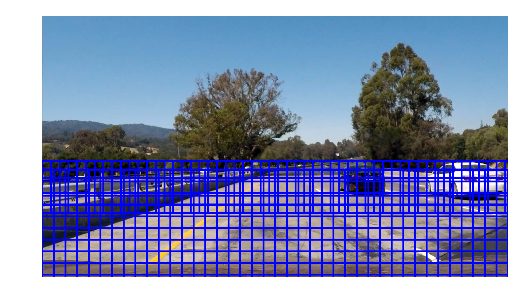

Total number of windows searched:  468


In [7]:
from detection_pipeline import get_sliding_windows_for_search
from image_utils import draw_boxes
sample_img = mpimg.imread('test_images/test1.jpg')
windows = get_sliding_windows_for_search(sample_img)
img = draw_boxes(sample_img, windows, thick=4)
plt.imshow(img)
plt.axis('off')
plt.show()

print("Total number of windows searched: ", len(windows))



### Sliding windows and prediction on image:
Here are the sample images with sliding windows detected as vehciles marked:


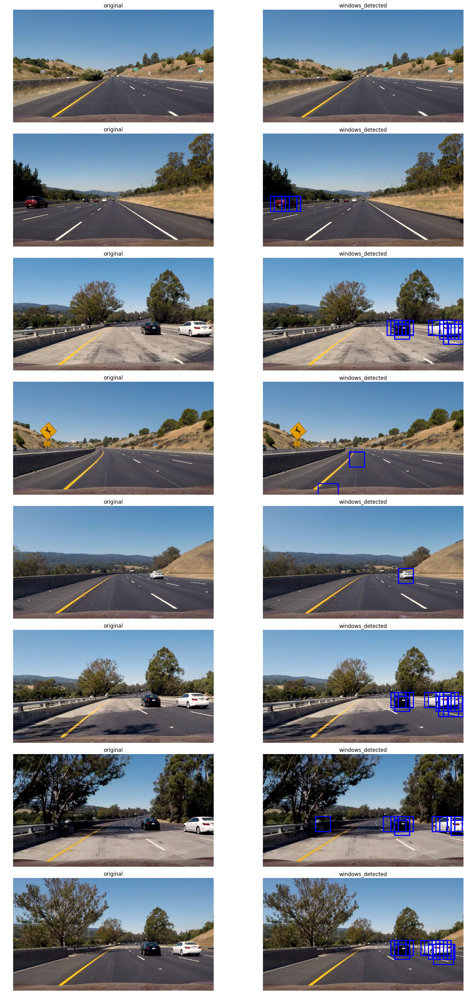

In [11]:
from detection_pipeline import gethotwindows

X_scaler = pickle.load(open("scalar.pkl", "rb"))
svm = pickle.load(open("svm.pkl", "rb"))

test_image_paths = glob.glob("test_images/*")
test_images = [mpimg.imread(path) for path in test_image_paths]

detected_windows_imgs = []
heatmap_imgs = []
final_window_imgs = []

for image in test_images:
    feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
    final_window_img, detected_windows_img, heatmap = detect_vehicles(image, svm, X_scaler, debug=True)
    heatmap_imgs.append(heatmap)
    detected_windows_imgs.append(detected_windows_img)
    final_window_imgs.append(final_window_img)

grid_plot( [('original', test_images),
            ('windows_detected', detected_windows_imgs)           
           ])

### Pipeline for Processing Video:
Here's the project video:
https://www.youtube.com/watch?v=NBnCBaGu7Wo


#### Dealing with multiple detections and false positives:
As you can see in the images above, there are multiple detections for cars in frames. Apart from that, there are some false positives on left side of the road. To deal with these, I am building a heat map by counting the number of detected windows that a cell falls in. If a cell is part of multiple detection windows, then it gets a higher 'heat'. I apply a threshold on this heat to discard false positives.

I then used scipy.ndimage.measurements.label() to identify individual blobs in the heatmap. I then assumed each blob corresponded to a vehicle. I constructed bounding boxes to cover the area of each blob detected. That helps us go from multiple detections for a car to a single bounding box for a car.

Apart from computing heat for a single image, I am keeping track of historic heat maps for the last 10 images, and I compute average heat value for the last N images, and threshold on this. In a way, we are tracking cars across multiple frames when we do this. This also helps throw away spurios detections that show up in a single frame.

Below are windows detected in image, their corresponding heatmap, and finally bounding boxes of cars once heat threshold and clustering is applied...

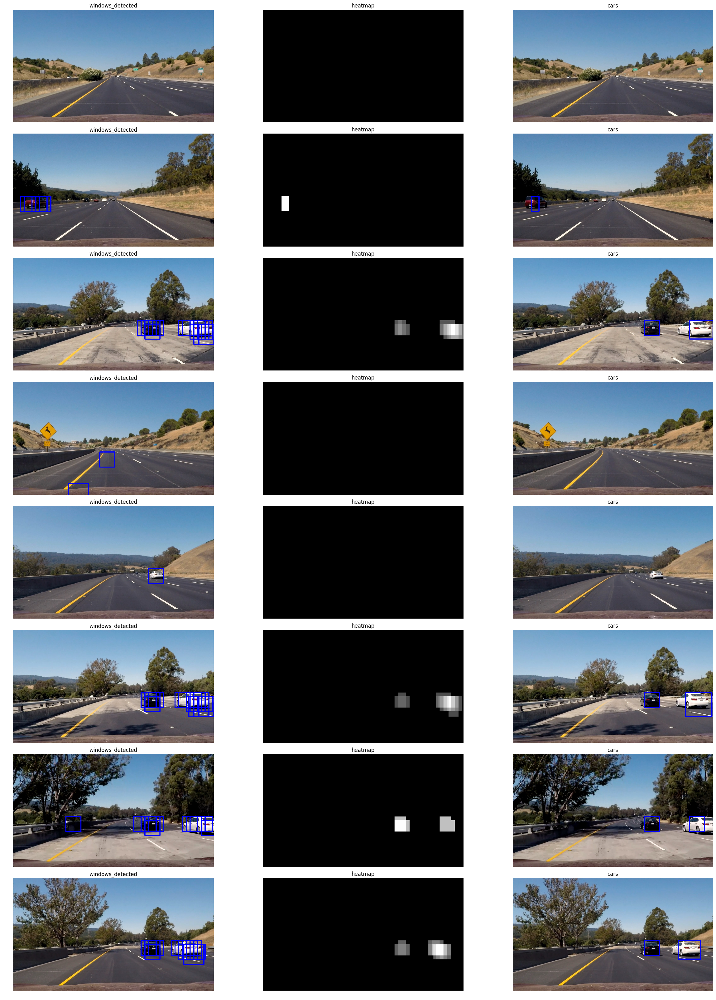

In [12]:
grid_plot( [
            ('windows_detected', detected_windows_imgs),
            ('heatmap', heatmap_imgs),
            ('cars', final_window_imgs) 
           ])
            

### Discussion:
- I learned a lot about computer vision from project 4 and 5. Personally though, I feel that deep learning is more intuitive for this classifier problem
- It takes on average 2.5 seconds per frame to process the image. Computation is slow because we are computing HOG individually for each window.
- An optimization to compute HOG once for the entire image actually reduces this compute time to under 0.5 seconds per frame. But, this is causing a lot more false positives. I spent a lot of time debugging issues there, but for no avail.
- Pipeline does a decent job, but when white car goes over bridge, we are loosing track of that. As next step, I will spend some time tweaking sliding window sizes and thresholds for this to work better.
- As a next step, I want to train a deep learning model for the same problem.